# Détection de clics

In [1]:
import pandas as pd
import os
import plotly.express as px
from scipy.signal import butter, sosfiltfilt
import numpy as np
import noisereduce as nr

os.chdir(os.path.dirname(os.getcwd()))

from scripts.utils.data_utils import select_labelled_audios
from scripts.utils.eda_utils import plot_site_count_by_pos_label,plot_spectrograms,plot_freq,visualize_spectrogram
from scripts.utils.performance_utils import plot_roc_curve


Importation du DataFrame comportant les labels

In [2]:

df = pd.read_csv("data/raw/Y_train_ofTdMHi.csv")
df["pos_label"]=df["pos_label"].astype(str)


### Overview de la base

In [3]:
px.histogram(df, x="pos_label", histnorm='percent',barmode="stack").show()

Il y a 60% de non-clics vs 40% de clics. Le jeu est à peine déséquilibré, ce qui ne devrait pas poser problème pour la modélisation.


In [4]:
plot_site_count_by_pos_label(df)

En revanche, il y a plus de contrastes entre les différents sites dans lesquels sont extraits les audios.

### Extraction des caractéristiques audio

Les données audio ne peuvent pas être directement utilisées comme entrée pour un modèle de deep learning. Il est nécessaire d'extraire des caractéristiques pertinentes des enregistrements audio pour capturer un maximum d'informations. Dans cette section, nous aborderons les différentes étapes pour préparer les données audio en vue de leur utilisation dans un modèle de deep learning.


Dans notre approche, nous souhaitons principalement utiliser des réseaux de neurones de type CNN (Réseau neuronal convolutif). En ce sens, les features utilisés pour le modèle seront exclusivement les spectrogrammes, qui sont finalement, la représentation graphique du signal sonore. Toutefois, il est également possible d'utiliser des transformations tel que la transformation de Fourier (sans graphique), la transformation en ondelettes et l'analyse en composantes principales pour extraire des features intéressantes. Ici, ce n'est pas cette approche qui a été adaptée principalement.



##### Importation des audios

Dans cette rubrique, on importe 5 extraits au hasard qui sont considérés comme des clics, et 5 qui ne le sont pas (positive vs negative). On regarde rapidement si les séries brutes sont exploitables ou non et on dégage de potentielles réflexions de cette aperçu.

Tous les audios durent 0.2secondes

**Audios brutes**

In [5]:

#On garde 5 audios classés comme positifs au clic et 5 négatifs
positive_audios = select_labelled_audios(df, "1.0", 5)
negative_audios = select_labelled_audios(df, "0.0", 5)
#On sélectionne une série de chaque pour continuer l'analyse
y_pos, sr_pos = positive_audios["00004-JAM.wav"]["signal"], positive_audios["00001-JAM.wav"]["signal_rate"]
y_neg, sr_neg = negative_audios["00010-JAM.wav"]["signal"], negative_audios["00005-JAM.wav"]["signal_rate"]


In [6]:

from IPython.display import Audio

Audio(y_pos,rate=sr_pos)


In [7]:
Audio(y_neg,rate=sr_neg)

**Aperçus des signaux bruts extraits d'audios comportant au moins un clic**

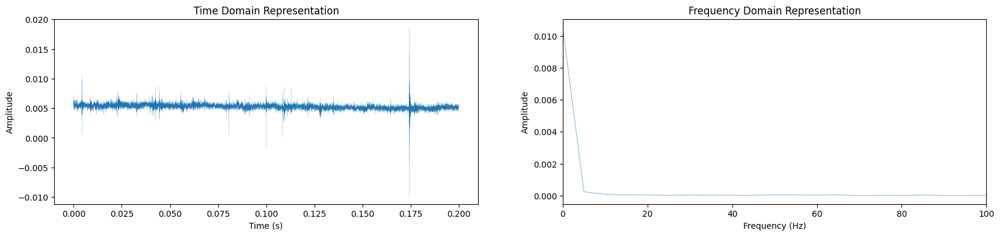

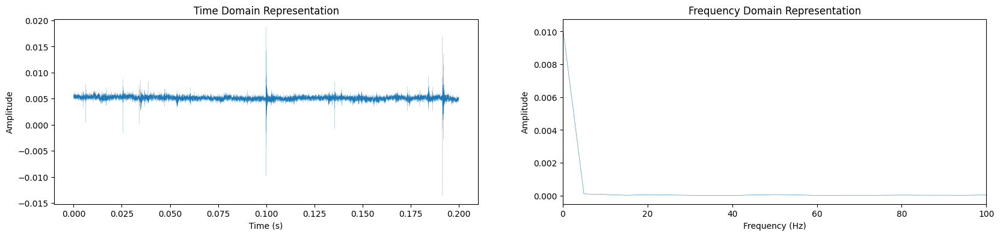

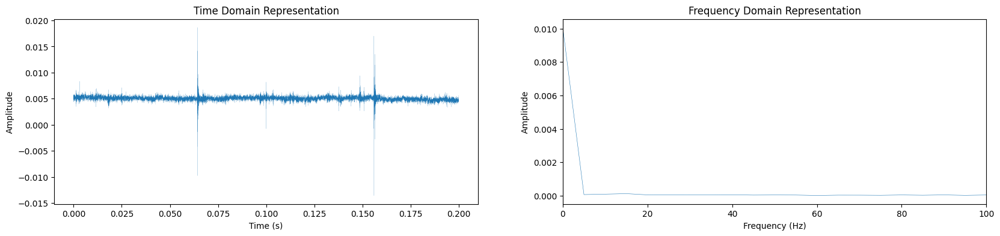

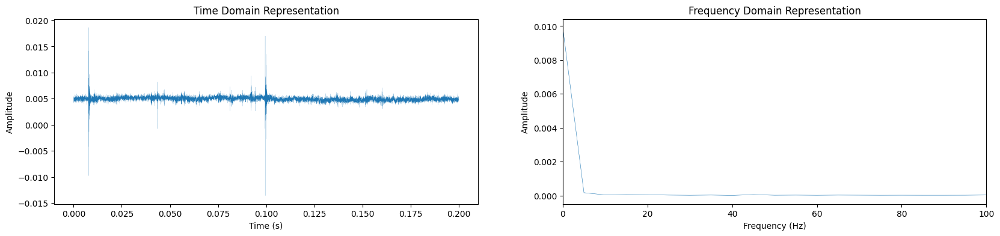

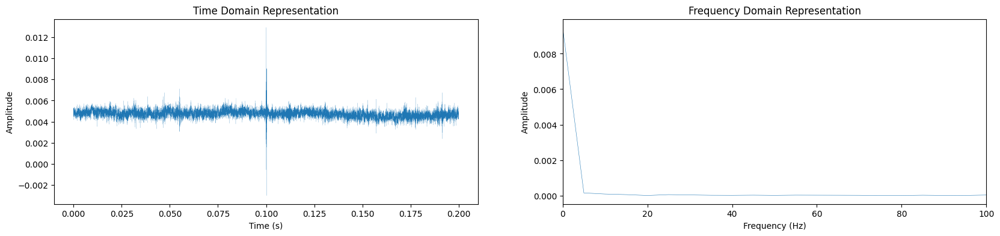

In [8]:
for audio,signals in positive_audios.items():
    plot_freq(signals["signal"], signals["signal_rate"])

**Aperçus des signaux bruts extraits d'audios ne comportant pas de clic**

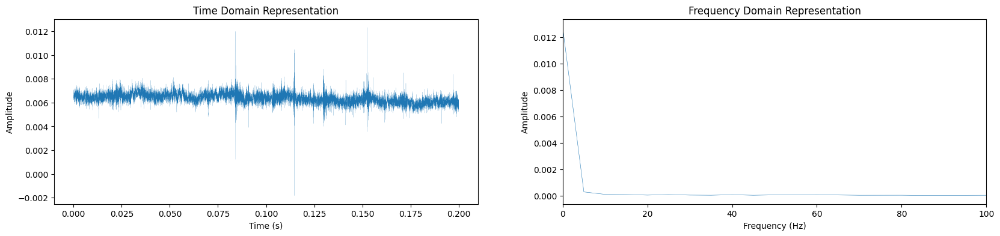

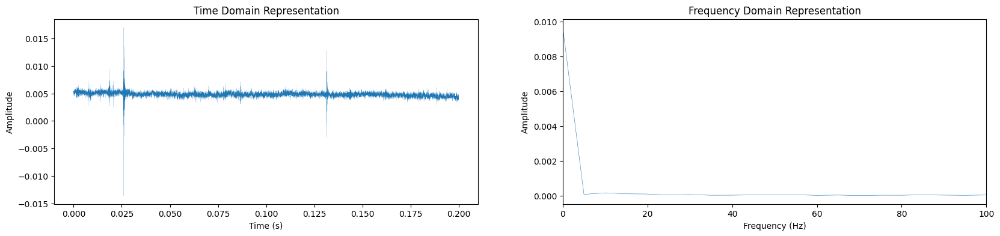

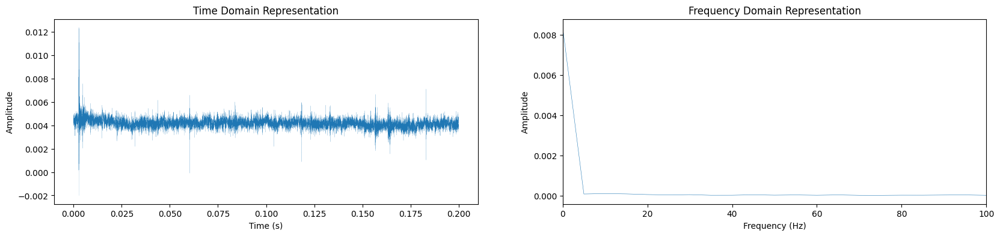

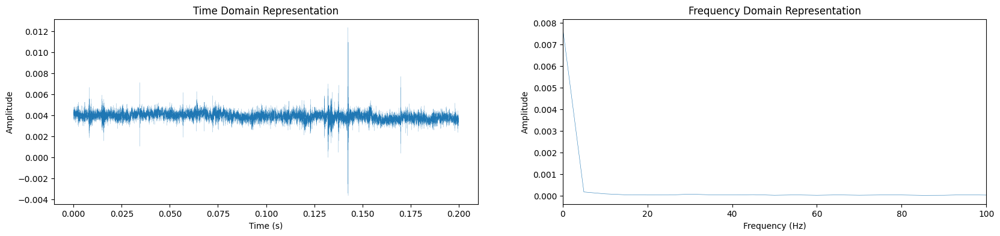

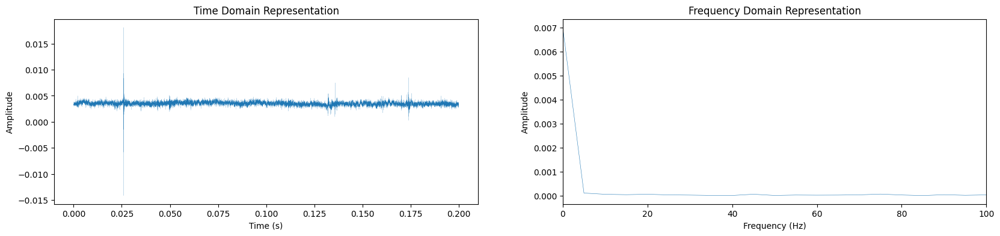

In [9]:
for audio,signals in negative_audios.items():
    plot_freq(signals["signal"], signals["signal_rate"])

##### Conclusion de l'analyse des signaux brutes:

Même s'il ne s'agit d'un échantillon de 5 audios pour chaque catégorie (clic/pas de clic), on remarque que:
- les deux types de signaux comportent tous des ondes ayant des amplitudes maximum similaires 
- les audios comportant des clics semblent avoir des pics de même amplitude et de façon régulière (et encore)

Il faut appliquer différentes transformations pour avoir plus d'informations provenant de ces audios.


##### **Transformation de l'audio en fréquences: La transformation de Fourier à court terme (STFT)**
La première étape consiste à transformer le signal audio temporel en une représentation fréquentielle à l'aide de techniques telles que la transformation de Fourier à court terme (STFT). 


Transformation de Fourier: C'est une technique mathématique utilisée pour décomposer un signal temporel en ses fréquences individuelles. En pratique, on utilise plutôt la version "discrète" (DFT) de cette transformation car elle est plus adaptée, par sa définition, aux signaux numériques/discrets qui sont souvent mesurés à des intervalles réguliers (et non de façon continue):

$X[k] = \sum_{n=0}^{N-1} x[n] e^{-j\frac{2\pi}{N} nk}$ 

où $x[n]$ est le signal discret, $X[k]$ est la transformée de Fourier discrète, $N$ est le nombre de points dans le signal et $n$ et $k$ sont des indices discrets.

La transformation de Fourier à court terme (STFT) est une extension de la transformation de Fourier discrète (DFT) qui fournit une représentation temps-fréquence d'un signal. Contrairement à la DFT qui montre uniquement les fréquences présentes, la STFT capture également l'évolution temporelle des fréquences en appliquant la DFT sur des segments de temps successifs. Pour réaliser la STFT, on divise le signal en segments de temps de même taille à l'aide d'une fonction fenêtre et on applique la DFT à chaque segment. En faisant glisser la fenêtre sur le signal avec un certain chevauchement entre les segments, on obtient une série de spectres de fréquences qui dépendent du temps. 


**Remarque:** On ne fait pas directement la STFT car nous choisirons les paramètres qui concernent la fenêtre de glissement au moment de la représentation en spectrogramme.


##### **Filtrage des bandes passantes et normalisation des fréquences**
Après la transformation en fréquences, il est important de filtrer les bandes passantes pour se concentrer sur les fréquences d'intérêt et éliminer celles non pertinentes pour l'analyse. De nombreuses études existent sur l'analyse des clics des dauphins/odontocètes, et il est généralement admis que le signal se trouve dans une bande de fréquences allant de quelques kilohertz à plus de 100 kHz (dans le cas présent, l'intervalle est entre 5 kHz et 100 kHz). En filtrant les données dans cette plage de fréquences, les chercheurs peuvent mieux analyser les signaux émis par ces animaux et comprendre leur comportement ainsi que leurs interactions avec l'environnement et d'autres espèces. 


In [10]:


# Paramètres de filtrage
lowcut = 5000.0  # 5 kHz
highcut = 100000.0  # 100 kHz

# Créer un filtre passe-bande avec les fréquences de coupure
order = 6  # Ordre du filtre

#SIGNAL POSITIF
sos = butter(order, [lowcut, highcut], btype='band', fs=sr_pos, output='sos')
filtered_signal_pos = sosfiltfilt(sos, y_pos)

#SIGNAL NEGATIF 
sos = butter(order, [lowcut, highcut], btype='band', fs=sr_neg, output='sos')
filtered_signal_neg = sosfiltfilt(sos, y_neg)



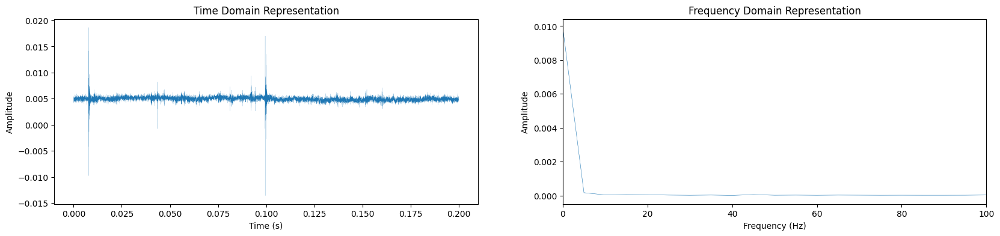

In [11]:
plot_freq(y_pos, sr_pos)


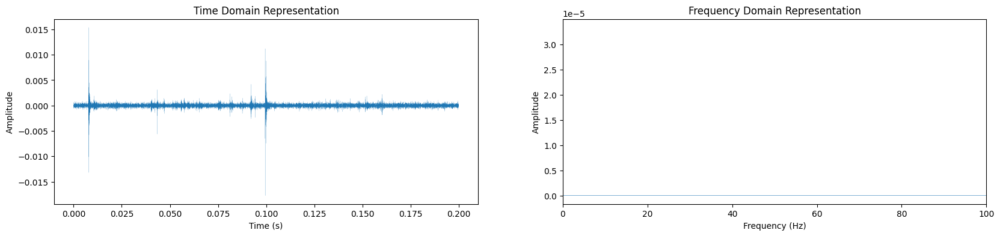

In [12]:
plot_freq(filtered_signal_pos, sr_pos)


On voit que, entre les pics, les ondes sont plus faibles et davantage proches de 0 qu'avant ce filtrage bande-passante.



##### **Choix de la représentation des audios: spectrogramme**

Le spectrogramme représente graphiquement un son, notamment les deux élements principaux qui caractérisent le son: la fréquence (en Hertz typiquement (Htz)) et l'intensité sonore (watt par mètre carré (W.m-2)) associée à chaque fréquence. 

Pour rappel:
- fréquence: nombre de fois qu'un phénomène périodique se reproduit dans le temps
- intensité acoustique/sonore: puissance transportée par les ondes sonores par unité de surface. Ce concept est souvent associé au niveau d'intensité sonore (souvent exprimé en Décibel Db)


Comme vu précédemment, le spectrogramme peut être obtenu via la STFT. En ce sens, le type de fenêtre (Hamming typiquement) peut être important pour la qualité graphique, ainsi que la taille de la fenêtre ("Frame size"), la taille de l'échantillon de chevauchement entre deux fenêtres ("Hop size").
D'autres représentations, comme le Mel-spectrogramme et MFCC (Mel Frequency Cepstral Coefficients), peuvent également être utilisées pour capturer des informations plus spécifiques sur le signal: Ces techniques sont en fait issus de STFT mais sont adaptées à la perception humaine des audios.  Même s'ils sont particulièrement adaptés pour les fréquences audibles pour l'humain, il s'agit de techniques également fiables pour la bioacoustique.





#### Spectrogrammes
Ici, on s'est inspiré de la fonction issue de ce repo [GitHub](), qui itère sur les différentes fenêtres utilisées pour la STFT ainsi qu'une grille de paramètres pour la taille de la fenêtre et la taille du chevauchement. On balaye ainsi les différentes combinaisons possibles pour voir quelle combinaison est susceptible de donner le plus d'informations. Il s'agit d'une méthode arbitraire de sélection de spectrogrammes.
Remarque:
- On utilise les séries STFT normalisées en Décibel. Pourquoi? Utiliser une échelle de type Décibel revient à utiliser une échelle logarithmique. En pratique, l'échelle logarithmique fait ressortir davantage de caractéristiques que le spectrogramme utilisant une simple échelle linéaire.
- On ajoute également le Mel-spectrogramme pour comparer avec les autres graphiques.


On voit ici qu'il s'agit d'une recherche par tâtonnement mais qu'il serait possible de trouver une GridSearch pour optimiser les paramètres en fonction de la tâche effectuée. En fait, comme le précise l'article Pre-processing spectrogram parameters improve the accuracy of bioacoustic classification using convolutional neural networks, la recherche des paramètres du spectrogramme peut avoir une influence notable sur les performances d'un modèle final. [citer]



/Users/luciegabagnou/miniconda/envs/biosonar/lib/python3.9/site-packages/librosa/feature/spectral.py:2157: UserWarning:

Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.



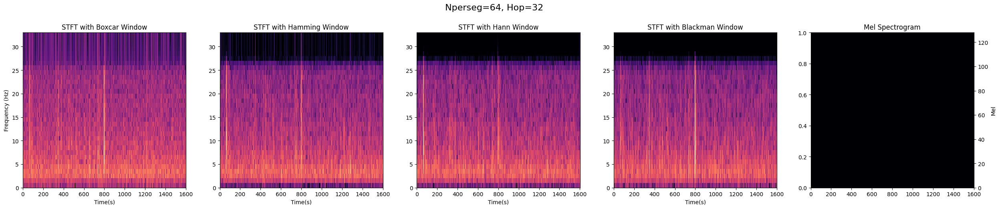

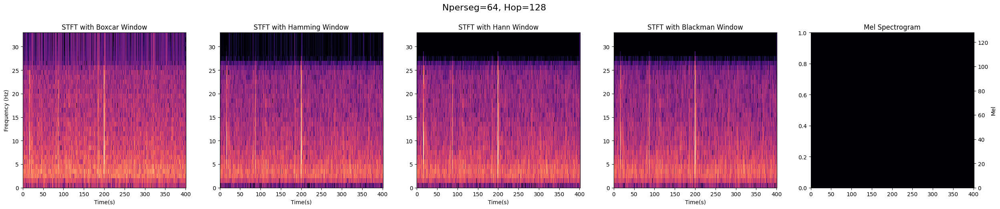

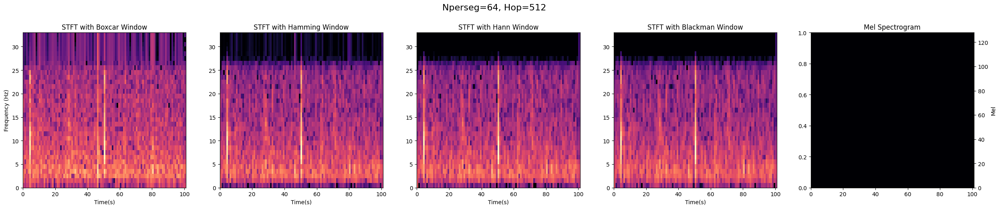

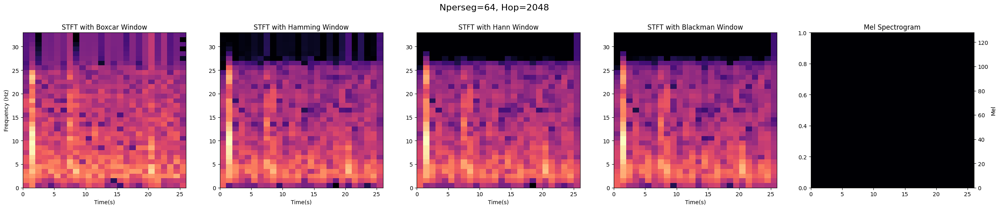

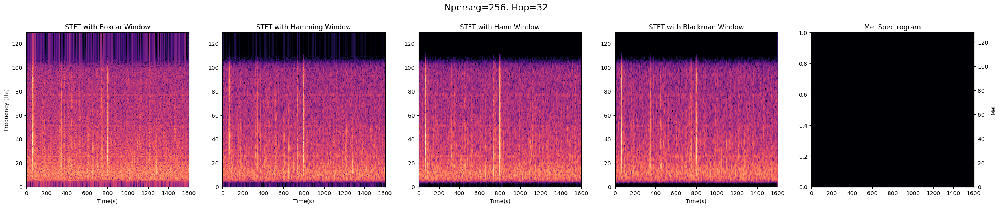

...

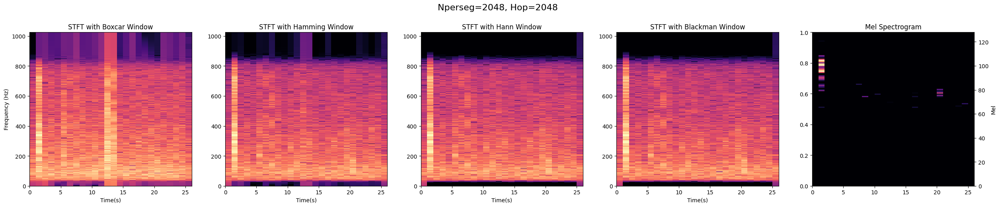

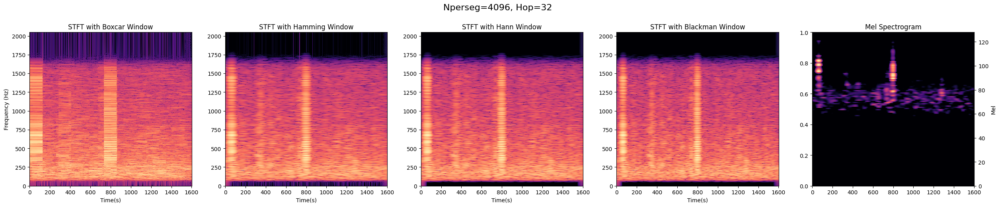

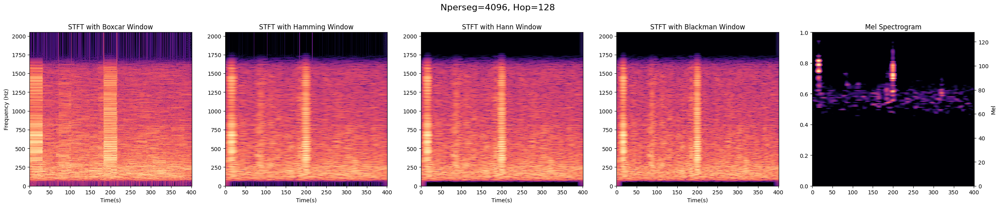

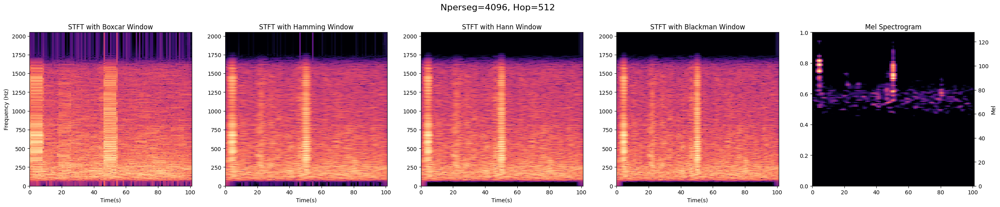

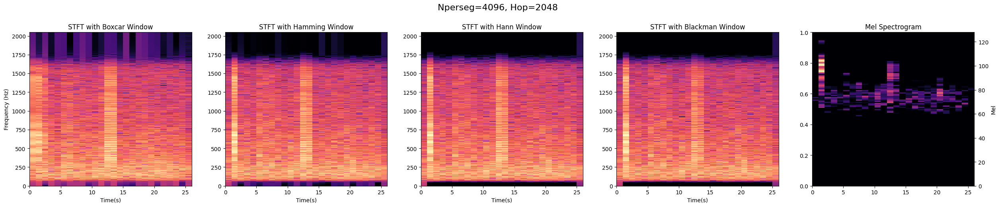

In [15]:
plot_spectrograms(filtered_signal_pos,sr_pos)

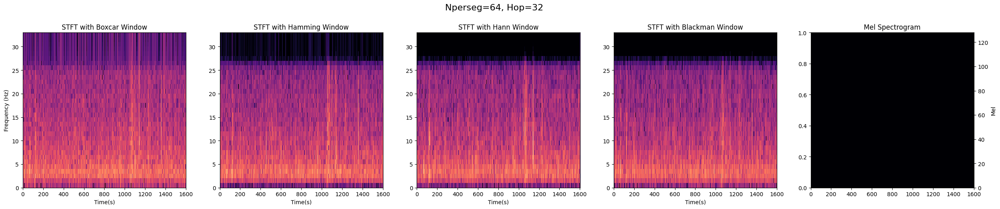

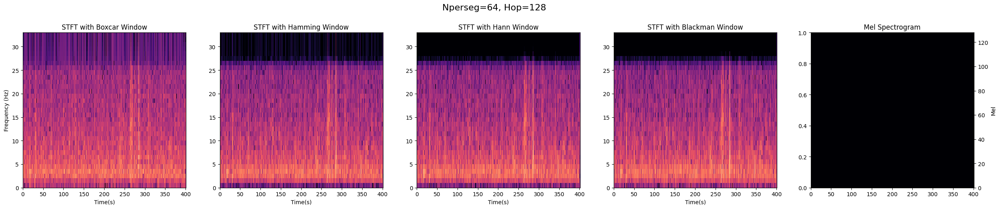

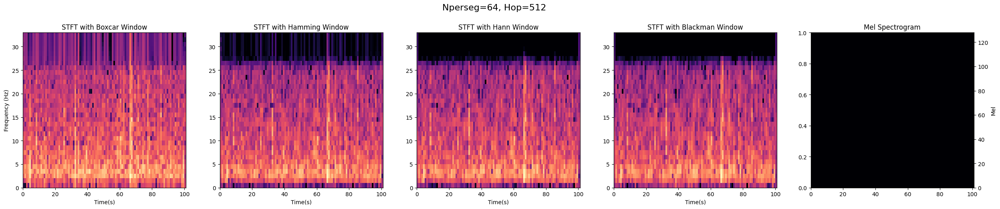

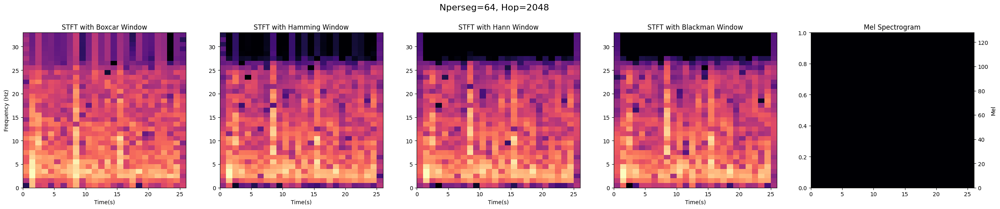

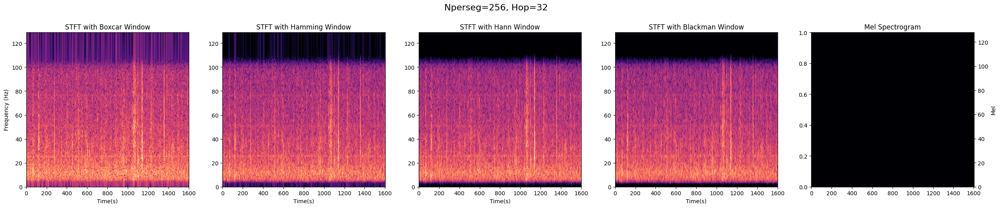

...

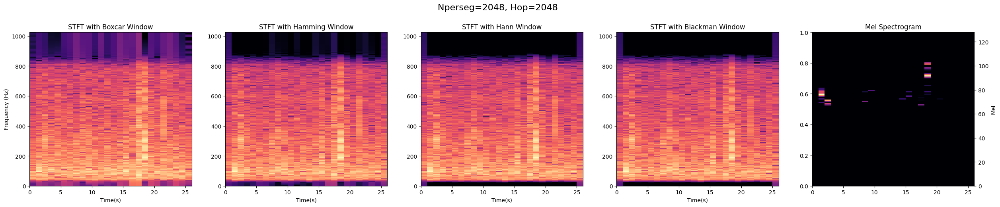

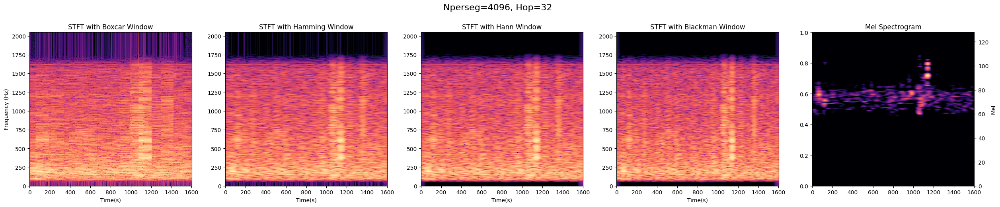

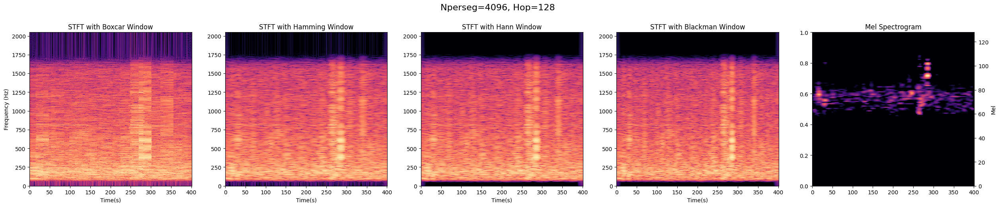

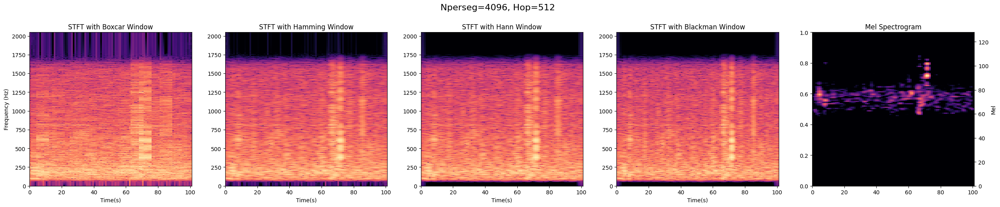

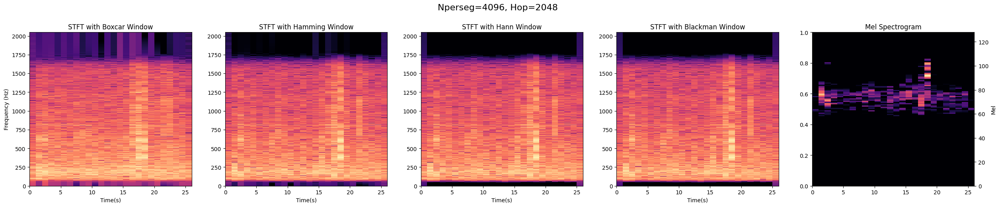

In [16]:
plot_spectrograms(filtered_signal_neg,sr_neg)

##### Conclusion
Il y a différentes combinaisons qui peuvent sembler adaptées. Après, tout dépend de ce qu'on souhaite capter comme information et quel est l'objectif. De plus, il faut également prendre en compte la résolution. Il s'agit d'un choix important car plus la résolution est importante, plus le code est difficile à tourner. 
Remarque: Il semblerait que la qualité de la fenêtre n'affecte que très peu la qualité:toutes les fenêtres donnent des représentations graphiques assez similaires.

Nous avons choisi la combinaison 1024 de taille de fenêtre et taille de chevauchement de 128 avec une fenêtre "Hamming". Ce choix est arbitraire mais semble assez similaire aux spectrogrammes d'odontocetes disponibles sur Internet. N'étant pas des experts en océanographie, nous ne pouvons pas savoir à quoi ressemblent les clics des odotoncètes sur les spectrogrammes.


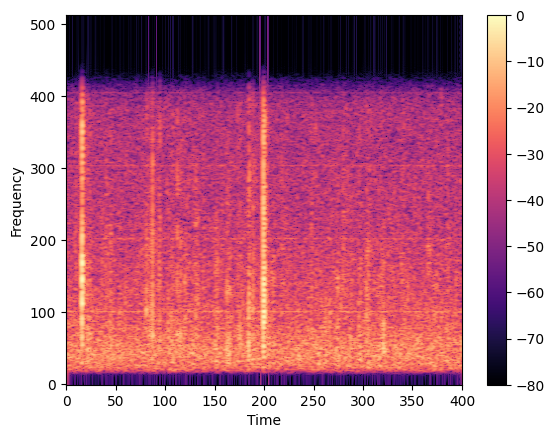

In [18]:
visualize_spectrogram(filtered_signal_pos)



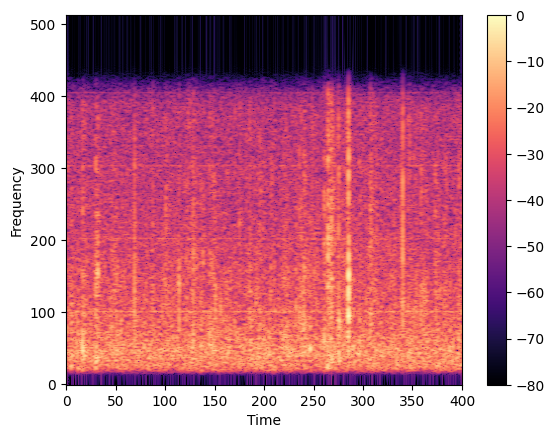

In [19]:
visualize_spectrogram(filtered_signal_neg)

##### Conclusion du spectrogramme
Au vu de ces graphiques, il semblerait que les graphiques représentant les clics d'odontocètes ont plus de hachures claires verticales bien distinctes. Les audios ne comportant pas de clics ont plus de bandes mais sont très fines.Peut-être que les audios comportant beaucoup de traits verticaux bien discernables caractérisent les clics?


##### **Réduction du bruit**

Des méthodes telles que la soustraction spectrale médiane ou le **filtrage de Wiener** peuvent être utilisées pour éliminer ou atténuer le bruit de fond.
Dans notre cas, nous testons le package disponible sur GitHub [noisereduce](https://github.com/timsainb/noisereduce) qui implémente l'algorithme Déconvolution de Wiener. Ce filtre, tente  de minimiser l'impact du bruit là où le rapport signal/bruit est mauvais. Ce filtrage est dit adaptatif car il n'est pas appliqué de la même façon le long du signal sonore.



In [23]:
from scripts.extractor.audio_extractor import median_noise_reduction,AudioProcessor


**Filtre Wiener**

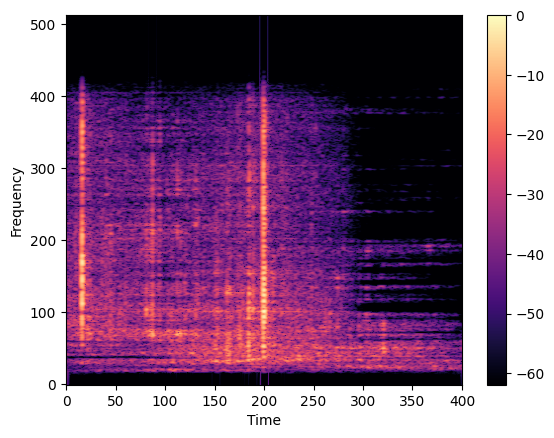

In [24]:

reduced_noise_pos = nr.reduce_noise(filtered_signal_pos, sr=sr_pos, n_std_thresh_stationary=1.5,stationary=True)
visualize_spectrogram(reduced_noise_pos)

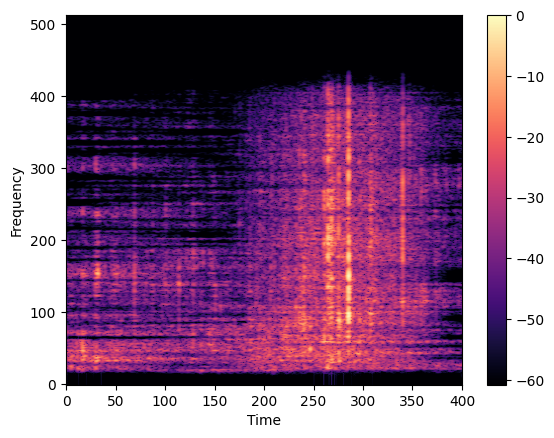

In [25]:
reduced_noise_neg = nr.reduce_noise(filtered_signal_neg, sr=sr_neg, n_std_thresh_stationary=1.5,stationary=True)
visualize_spectrogram(reduced_noise_neg)

**Filtrage par la médiane**

In [26]:
reduced_noise_pos = median_noise_reduction(filtered_signal_pos,sr_pos)
reduced_noise_neg =  median_noise_reduction(filtered_signal_neg,sr_neg)

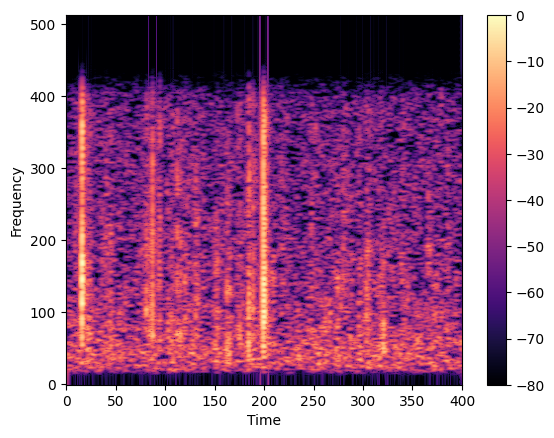

In [27]:

visualize_spectrogram(reduced_noise_pos)

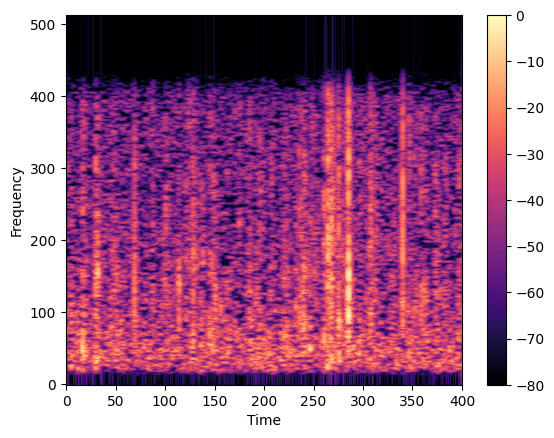

In [28]:

visualize_spectrogram(reduced_noise_neg)

On tentera un modèle avec ces images pour voir si les performances sont meilleures ou non, mais pour l'instant on va utiliser les spectrogrammes avant cet étape. En fait, ces graphiques mettent en avant le constat précédent, c'est-à-dire, le fait qu'il y ait beaucoup plus de faisceaux verticaux dans l'audio ne comportant pas des clics. On retiendra davantage l'approche par le filtrage de Wiener.

#### Conclusion de l'analyse exploratoire

Nous avons appliqué différentes transformations pour tenter de capter le maximum d'informations des enregistrements bruts, à savoir la transformation STFT, le filtrage bande-passante ainsi qu'une réduction de bruit avec le filtrage de Wiener. De plus, nous avons choisi la représentation graphique, à savoir un spectrogramme issue d'une STFT avec une fenêtre **Hamming**, une taille de chevauchement de **128** et une taille de fenêtre à **2048**.

#### Pipeline
Maintenant qu'on a défini quels étaient les différentes procédures pour traiter les enregistrements, nous définissons une pipeline propre à notre environnement de travail, qui va appliquer le même traitement pour l'ensemble des audios disponibles dans un dossier. 

##### Regroupement par site
Pour faire en sorte que le calcul soit soutenable par notre machine, nous créeons des "batchs" pour la phase de création de spectrogrammes avec group_filenames_by_site.
Après avoir récupéré les spectogrammes de chaque site, on concatène tout avec aggregate_npy_files.

In [30]:
from scripts.utils.data_utils import group_filenames_by_site,aggregate_npy_files
from tqdm import tqdm


id_audios = df.id.values.tolist()
grouped_filenames = group_filenames_by_site(id_audios)
x_train_audio_dir = "data/raw/X_train"
x_train_output_dir = "data/intermediate/X_train"

In [31]:

#Utilisation de la classe AudioProcessor qui applique les prétraitements énoncés dans la partie précédente + redimensionne et normalise
audio_processor=AudioProcessor(audio_dir = x_train_audio_dir,output_base_dir = x_train_output_dir,size_image=(150,150),grey_option=False)

for site, file_list in tqdm(grouped_filenames.items(), desc="Processing sites"):
    audio_processor.process_train(site, file_list, df)

Processing sites: 100%|██████████| 8/8 [00:00<00:00, 11362.83it/s]

PROCESSING JAM
Skipping JAM as files already exist.
PROCESSING StEUS
Skipping StEUS as files already exist.
PROCESSING BON
Skipping BON as files already exist.
PROCESSING BAHAMAS
Skipping BAHAMAS as files already exist.
PROCESSING GUA
Skipping GUA as files already exist.
PROCESSING ARUBA
Skipping ARUBA as files already exist.
PROCESSING StMARTIN
Skipping StMARTIN as files already exist.
PROCESSING BERMUDE
Skipping BERMUDE as files already exist.


In [ ]:
aggregate_npy_files(x_train_output_dir,"spectrograms.npy",True,"X.npy")
aggregate_npy_files(x_train_output_dir,"labels.npy",True,"y.npy",)

#9min30

In [ ]:
#Applique un traitement quasi-similaire sur X_test
audio_dir_test="data/raw/X_test"
output_base_dir_test = "data/intermediate/X_test"
audio_processor=AudioProcessor(audio_dir = audio_dir_test,output_base_dir = output_base_dir_test,size_image=(150,150),gray_option=True)
files_test = [os.path.basename(f) for f in os.listdir(audio_dir_test) if f.endswith('.wav')]
audio_processor.process_test("", files_test)
X_test=np.load(output_base_dir_test+"/"+"spectograms.npy")
np.save("X.npy",X_test)

### Utilisation de modèles de Deep Learning pour la classification des clics

#### Approches envisagées

Pour rappel, notre objectif est de prédire si un enregistrement audio contient ou non des clics d'odontocètes, ce qui correspond à une tâche de classification binaire. Après avoir traité les enregistrements audio pour obtenir des images sous forme de spectrogrammes, nous avons élaboré un modèle de classification en utilisant différents architectures de réseaux de neurones.

Nous nous sommes inspirés de [*Computational bioacoustics with deep learning: a review and roadmap*]( https://www.ncbi.nlm.nih.gov/pmc/articles/PMC8944344/papier) de ***Dan Stowell*** pour connaître l'Etat de l'art pour les modèles de Deep Learning particulièrement adapté à la classification "bioacoustique". Parmi les différents types de réseaux de neurones, nous avons implémenté les suivants:
- CNN(Convolutional Neural Networks) en utilisant des architectures: une baseline et un modèle VGG16 (sans pré-entraînement)
- Transfer Learning:  même si les modèles pré-entraînés sont principalement entraînés sur des images naturelles (pas forcément des spectogrammes), il convient de tester cette approche car le volume de données d'entraînement pour ces modèles est tellement important que cela permet dans la plupart des cas d'avoir un modèle qui "out performe". Nous tenterons également une technique de Data Augmentation pour voir si cela influe peut améliorer les performances.

Nous avions pensé également au CRNN (Convolutional Recurrent Neural Networks), un mix entre les CNN et les RNN (Recurrent Neural Networks) pour extraire les caractéristiques visuelles mais également les dépendances temporelles dans les spectrogrammes.

#### Préparation du jeu de données
Rapidement, on réalise un découpage du jeu de données classique:
- D'une part nous disposons de X_train, dont les labels sont connus: On divise cet échantillon en un set d'apprentissage et de validation (X_train,X_valid,y_train,y_valid). Cela permet d'ajuster les hyperparamètres tel que le nombre d'epochs, l'optimiseur, ou le taux d'apprentissage.
- D'autre part, nous avons X_test,qui est utilisé pour les prédictions à soumettre sur Challenge ENS

In [34]:

from sklearn.model_selection import train_test_split

X = np.load("X.npy")
y=np.load("y.npy")
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.3, random_state=42) # On fixe la taille de l'échantillon de validation à 30% et l'échantillon de train à 70%

print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", X_valid.shape)
print("y_test shape:", y_valid.shape)


X_train shape: (16217, 150, 150, 3)
y_train shape: (16217,)
X_test shape: (6951, 150, 150, 3)
y_test shape: (6951,)


#### CNN

In [32]:
from scripts.modeler.OdontoceteCNN_model import OdontoceteCNNClassifier
from scripts.modeler.VGG16_model import VGG16Classifier

Metal device set to: Apple M2

systemMemory: 16.00 GB
maxCacheSize: 5.33 GB



/Users/luciegabagnou/miniconda/envs/biosonar/lib/python3.9/site-packages/keras/optimizers/optimizer_v2/adam.py:110: UserWarning:

The `lr` argument is deprecated, use `learning_rate` instead.

2023-05-01 02:59:11.552720: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-05-01 02:59:11.552801: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


##### Modèle de baseline
Le OdontoceteCNNClassifier est un réseau de neurones convolutif (CNN) personnalisé conçu pour détecter les clics d'odontocètes dans des spectrogrammes. La structure générale du modèle comprend :

- Une couche d'entrée pour prendre en compte les images de spectrogramme.
- Quatre blocs de convolution (ConvBlock) comprenant chacun :
    - Une couche de convolution 2D pour l'extraction des caractéristiques.
    - Une couche de normalisation par lots (BatchNormalization) pour accélérer l'entraînement et améliorer la stabilité.
    - Une couche d'activation ReLU pour introduire la non-linéarité.
    - Une couche de MaxPooling2D pour réduire la dimensionnalité (à l'exception du dernier ConvBlock).
- Une couche de Global Average Pooling pour réduire la dimensionnalité des cartes de caractéristiques.
- Une couche dense (fully connected) avec une activation ReLU pour la classification.
- Une couche dense de sortie avec une activation sigmoïde pour prédire la probabilité d'un clic d'odontocète.

In [ ]:
odontocete_classifier = OdontoceteCNNClassifier()
odontocete_classifier.compile()
odontocete_classifier.summary()
odontocete_classifier.model.fit(X_train, y_train, batch_size=32, epochs=20, verbose=1, validation_data=(X_valid,y_valid))

Comme ce modèle semblait avoir de performances mais que l'accuracy sur l'échantillon de validation variait beaucoup entre deux epochs (jusqu'à 0.40 de différence), nous avons tenté ce même modèle mais en utilisant un optimiseur SGD (Stochastic Gradient Descent) qui est un autre type d'optimiseur avec un momentum fixé arbitrairement à 0.9. Cela a permis de gagner 0.02 en accuracy, ce qui reste notable.

In [ ]:
from keras import optimizers
odontocete_classifier = OdontoceteCNNClassifier()
odontocete_classifier.compile(optimizer=optimizers.SGD(lr=1e-4, momentum=0.9))
odontocete_classifier.summary()
odontocete_classifier.model.fit(X_train, y_train, batch_size=32, epochs=20, verbose=1, validation_data=(X_valid,y_valid))

##### VGG16

VGG est une architecture de CNN développée par l'équipe Visual Geometry Group de l'Université d'Oxford. La principale caractéristique de VGG est l'utilisation de couches convolutives avec de petits filtres (3x3) et un stride (pas de déplacement du filtre) de 1, empilées les unes sur les autres pour capturer des caractéristiques. L'architecture comprend également des couches de MaxPooling pour réduire la dimensionnalité et des couches entièrement connectées pour la classification finale. La version VGG16 a été implémentée dans l'étude.

Dans un premier temps, on utilise ce modèle sans poids d'un modèle pré-entraîné. On entraîne cette architecture uniquement sur nos données.

In [ ]:
vgg16_classifier = VGG16Classifier(weights=None)
vgg16_classifier.compile()
vgg16_classifier.summary()
history = vgg16_classifier.model.fit(X_train, y_train, batch_size=32, epochs=20, verbose=1, validation_data=(X_valid, y_valid))

####

#### Transfer Learning

On utilise dans un premier temps VGG16 entraîné sur ImageNet (une base de données qui contient plus de 14 millions d'images annotées à la main, réparties en plus de 21 000 catégories. Les images sont principalement centrées sur des objets et des animaux, mais incluent d'autres élements également.)

In [ ]:

vgg16_classifier = VGG16Classifier(weights="imagenet")
vgg16_classifier.compile()
history = vgg16_classifier.model.fit(X_train, y_train, batch_size=32, epochs=20, verbose=1, validation_data=(X_valid, y_valid))

#### Transfer Learning avec MobileNetV2 et augmentation de données
MobileNet (V2) est une architecture de CNN développée par Google en 2018 dans le but d'être utilisé des appareils mobiles avec des ressources limitées en calcul. Elle utilise une technique appelée "bottleneck residual block" pour réduire la dimensionnalité du réseau, tout en conservant des performances élevées.

Data Augmentation: Il s'agit d'une technique générant des données supplémentaires. En utilisant les images de la base d'origine, la Data Augmentation consiste en réaliser différentes transformations aléatoires (recadrage, orientation, bruit supplémentaire) dans le but d'enrichir la variabilité des données (et d'éviter le sur-apprentissage)


In [ ]:
from scripts.modeler.MobileNetV2_model import MobileNetV2Classifier
from scripts.modeler.data_augmentation import DataAugmentation
import keras

data_augmentation = DataAugmentation(rescale=1./255, shear_range=0.2, zoom_range=0.2, horizontal_flip=True)
train_generator = data_augmentation.get_train_generator(X_train, y_train, batch_size=32)
valid_generator = data_augmentation.get_valid_generator(X_valid, y_valid, batch_size=32)



mobilenet_v2_classifier = MobileNetV2Classifier(input_shape=(150, 150, 3), num_classes=1, weights=None)
mobilenet_v2_classifier.compile(loss='binary_crossentropy', optimizer=optimizers.Adam(lr=0.0001), metrics=['accuracy', keras.metrics.AUC(name='auc')])
mobilenet_v2_classifier.summary()
mobilenet_v2_classifier.model.fit_generator(
    train_generator,
    steps_per_epoch=len(X_train) // 32,
    epochs=20,
    validation_data=valid_generator,
    validation_steps=len(X_valid) // 32)

#### Résultats 
Pour chaque modèle, on montre ici les performances sur l'échantillon de validation. Néanmoins, seules les performances sur l'échantillon de test sont finalement importantes pour dire que le modèle est performant ou non.

In [46]:
vgg16 = keras.models.load_model("models/vgg16/VGG16_20epochs.h5")
odontocetecnn=keras.models.load_model("models/baseline/CNNSGD.h5")
vgg16_imagenet_finetuned=keras.models.load_model("models/vgg16/VGG16_20epochs_imagenet.h5")
mobilenetv2_finetuned_augmented_data=keras.models.load_model("models/mobilnet/mobilnetV2_augmented.h5")


2023-05-01 02:12:35.575736: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


218/218 [==============================] - 45s 207ms/step


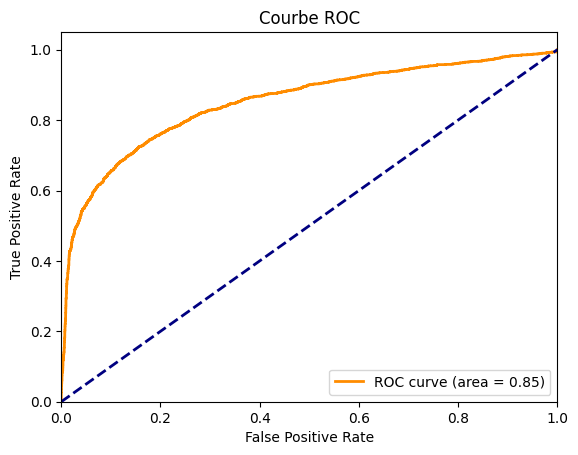

In [44]:


y_pred_probs = vgg16.predict(X_valid)
plot_roc_curve(y_valid, y_pred_probs)

  1/218 [..............................] - ETA: 41s

2023-05-01 02:13:21.840033: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


218/218 [==============================] - 14s 62ms/step


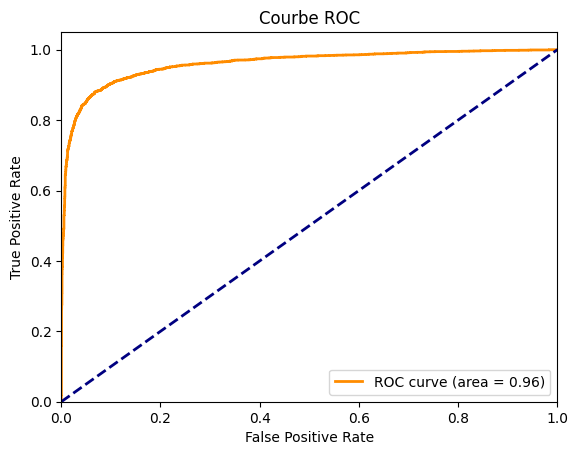

In [45]:
y_pred_probs = odontocetecnn.predict(X_valid)
plot_roc_curve(y_valid, y_pred_probs)

2023-05-01 02:13:36.005504: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


218/218 [==============================] - 69s 317ms/step


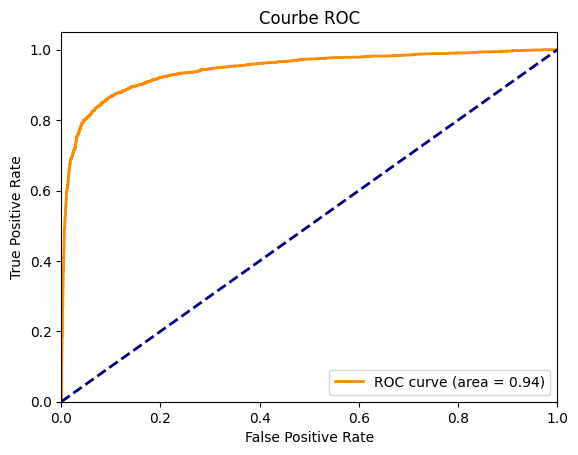

In [46]:
y_pred_probs = vgg16_imagenet_finetuned.predict(X_valid)
plot_roc_curve(y_valid, y_pred_probs)

2023-05-01 03:05:54.252794: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


218/218 [==============================] - 11s 47ms/step


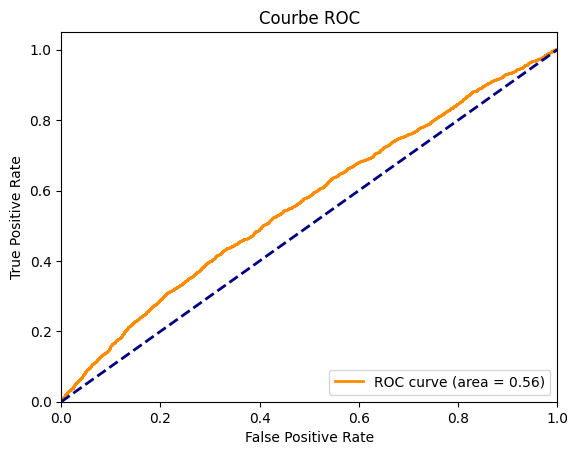

In [47]:

y_pred_probs = mobilenetv2_finetuned_augmented_data.predict(X_valid)
plot_roc_curve(y_valid, y_pred_probs)

On voit bien que notre modèle baseline sur-performe l'ensemble des modèles sur l'échantillon de validation.

#### Pipeline d'inférence


In [122]:
X_test = np.load("data/intermediate/X_test/X_test.npy")
model = keras.load("models/baseline/CNNSGD.h5")
test_preds = model.predict(X_test)
ids_test=[os.path.basename(elem) for elem in os.listdir(audio_dir_test) if elem.endswith(".wav")]
test_preds=[value[0] for value in test_preds.tolist()]
preds = pd.DataFrame({"id":ids_test,"pos_label":test_preds})
preds=preds.set_index("id")
preds.to_csv("y_test.csv")